In [1]:
from functions_py import *
import matplotlib.pyplot as plt
#from mpl_toolkits.axes_grid1 import make_axes_locatable

In [2]:
plt.rcParams.update({
    "image.origin": "lower",
    "image.aspect": 1,
    #"text.usetex": True,
    "grid.alpha": .5,
    "axes.linewidth":2,
    "lines.linewidth" : 1,
    "font.size":    15.0,
    "xaxis.labellocation": 'right',  # alignment of the xaxis label: {left, right, center}
    "yaxis.labellocation": 'top',  # alignment of the yaxis label: {bottom, top, center}
    "xtick.top":           True ,  # draw ticks on the top side
    "xtick.major.size":    8    ,# major tick size in points
    "xtick.minor.size":    4      ,# minor tick size in points
    "xtick.direction":     'in',
    "xtick.minor.visible": True,
    "ytick.right":           True ,  # draw ticks on the top side
    "ytick.major.size":    8    ,# major tick size in points
    "ytick.minor.size":    4      ,# minor tick size in points
    "ytick.direction":     'in',
    "ytick.minor.visible": True,
    "ytick.major.width":   2   , # major tick width in points
    "ytick.minor.width":   1 ,
    "xtick.major.width":   2   , # major tick width in points
    "xtick.minor.width":   1 ,
    "legend.framealpha": 0 ,
    "legend.loc": 'best',

})

# Michrochip images

## Raw Image

Filename: /home/oem/Software/cursoInstrumentacion_2022/ClasesPy/71-CopyPedro/proc_skp_m-009_microchip_T_170__Vv82_NSAMP_324_NROW_400_NCOL_700_EXPOSURE_0_NBINROW_1_NBINCOL_1_img_100.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     165   (700, 400)   float32   
  1                1 ImageHDU       164   (700, 400)   float32   
  2                1 ImageHDU       164   (700, 400)   float32   
  3                1 ImageHDU       164   (700, 400)   float32   
None
----------------


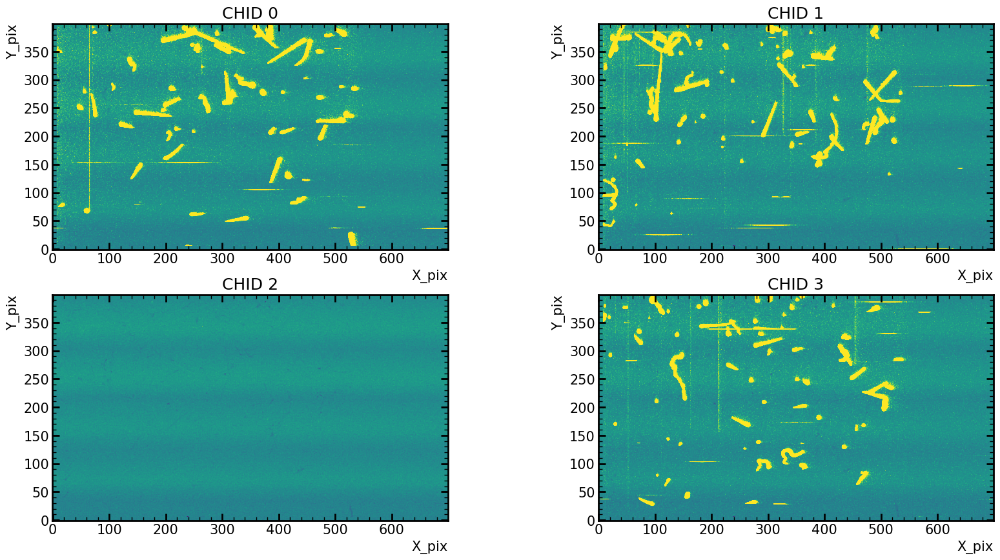

In [3]:
path='/home/oem/Software/cursoInstrumentacion_2022/ClasesPy/71-CopyPedro/proc_skp_m-009_microchip_T_170__Vv82_NSAMP_324_NROW_400_NCOL_700_EXPOSURE_0_NBINROW_1_NBINCOL_1_img_100.fits'
hdu_list = fits.open(path)
print(hdu_list.info())
print('----------------')
# hdu_list[0].header
plt.figure(figsize=(20,10))
for i in range(4):
    plt.subplot(2,2,i+1)
    plt.imshow(hdu_list[i].data-np.median(hdu_list[i].data),vmin=-800,vmax=800)
    plt.title('CHID '+str(i))
    plt.ylabel('Y_pix')
    plt.xlabel('X_pix')
plt.show()

## Calibrated imges, medians subtracted, cleaned xtalk

CHID 0 Gain:(212.55 +- 0.48)ADUs
CHID 1 Gain:(206.74 +- 0.47)ADUs
CHID 2 Gain:(219.28 +- 529.14)ADUs
CHID 3 Gain:(187.35 +- 0.50)ADUs


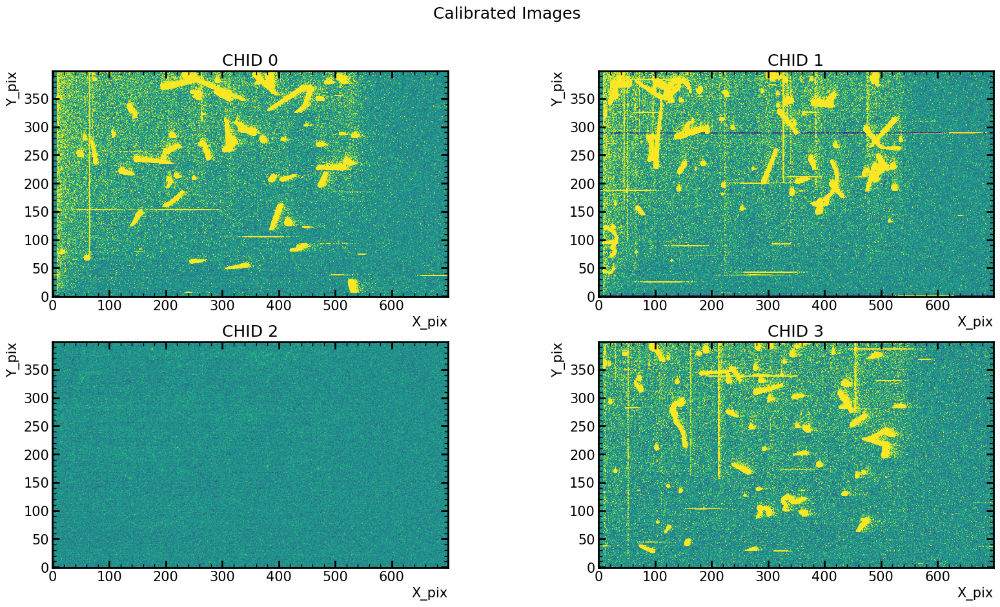

In [4]:
data_pre = precal(hdu_list,extensions=4)
gain, gain_err, data,_,_,_= LocalCalib(data_pre,extensions=4)
fig=plt.figure(figsize=(20,10))
for i in range(4):
    plt.subplot(2,2,i+1)
    plt.imshow(data[i],vmin=-1,vmax=1)
    plt.title('CHID '+str(i))
    plt.ylabel('Y_pix')
    plt.xlabel('X_pix')
    print("CHID "+str(i)+' Gain:({:.2f} +- {:.2f})ADUs'.format(gain[i],gain_err[i]))
plt.suptitle('Calibrated Images')
plt.savefig('IMAGES_POSCALIB.png', bbox_inches='tight', dpi=100)
    
plt.show()

    

In [5]:
sigma, sigma_err = LocalSigma(data,extensions=4)
for i in range(4):
    print('CHID '+str(i),r' Noise: ({:.3f} +- {:.3f}) e-'.format(sigma[i],sigma_err[i]))

CHID 0  Noise: (0.206 +- 0.001) e-
CHID 1  Noise: (0.221 +- 0.001) e-
CHID 2  Noise: (0.215 +- 0.001) e-
CHID 3  Noise: (0.253 +- 0.001) e-


# Masking

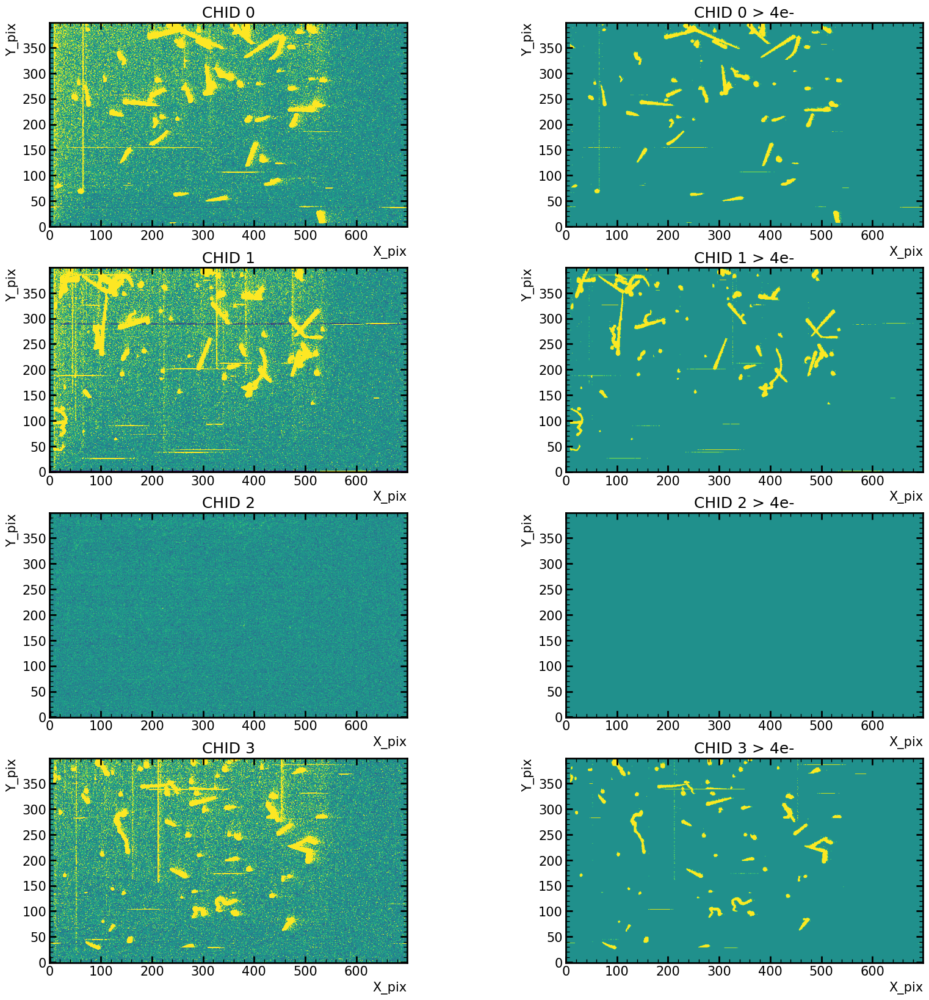

In [6]:
fig=plt.figure(figsize=(20,20))
for i in range(4):
    plt.subplot(4,2,2*(i+1)-1)
    plt.imshow(data[i],vmin=-1,vmax=1)
    plt.title('CHID '+str(i))
    plt.ylabel('Y_pix')
    plt.xlabel('X_pix')
    plt.subplot(4,2,2*(i+1))
    plt.imshow(data[i]>4,vmin=-1,vmax=1)
    plt.title('CHID '+str(i)+' > 4e-')
    plt.ylabel('Y_pix')
    plt.xlabel('X_pix')
plt.show()

In [7]:
import skimage.measure as sk

In [8]:
label=ndimage.label(data[1]>4,structure=[[1,1,1],[1,1,1],[1,1,1]])[0]

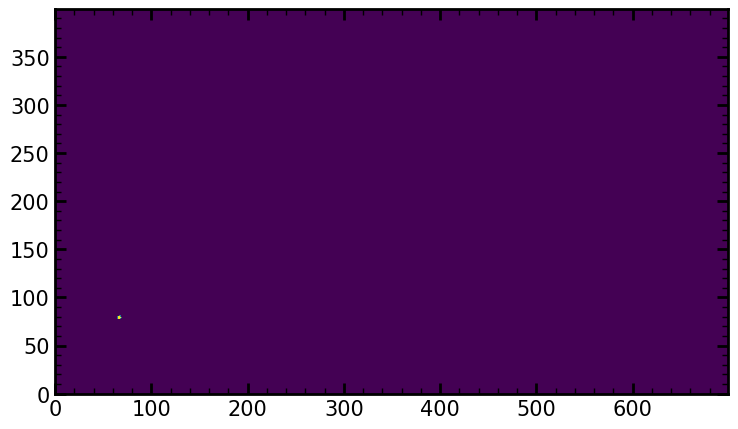

In [9]:
plt.figure(figsize=(15,5))
plt.imshow(label==38)
plt.show()

Getting only the High Energy Events

In [10]:
def sum_intensity(region, intensities):
    return np.sum(intensities[region])

rps=sk.regionprops(label,intensity_image=data[1],cache=False, extra_properties=[sum_intensity])
areas=[r.area for r in rps]
energy=[r.sum_intensity for r in rps]
centr=[r.weighted_centroid for r in rps]
ecce=[r.eccentricity for r in rps]
dic_props={"areas":areas,"energias":energy,'centroid':centr, "excentricidade":ecce}

In [11]:
import skimage as ski
ski.__version__

'0.19.3'

In [12]:
df=pd.DataFrame.from_dict(dic_props)
df.index = np.arange(1, len(df)+1)
df.head(35)

,areas,energias,centroid,excentricidade
1,1,5.439818,"(1.0, 530.0)",0.000000
2,2,12.098912,"(1.0, 533.3454099049212)",1.000000
3,72,1377.008828,"(1.0, 574.0909439983725)",1.000000
4,5,36.376352,"(1.0, 611.7610904491692)",1.000000
5,1,4.371377,"(1.0, 616.0)",0.000000
6,1,5.427404,"(1.0, 618.0)",0.000000
7,1,4.358612,"(26.0, 80.0)",0.000000
8,1,5.750969,"(26.0, 82.0)",0.000000
9,50,718.564880,"(26.0, 111.0978777761648)",1.000000
10,11,77.381168,"(26.0, 140.90728687807456)",1.000000


In [13]:
energias=dic_props["energias"]
exce=dic_props["excentricidade"]
hee_list=np.where((np.array(energias)>80) & (np.array(exce)!=1))[0].tolist() #index od the dictionary of events ---> TRESHOLD OF 80 ELECTRONS TO BE HE

In [14]:
areas=dic_props["areas"]
see_list=np.where((np.array(exce)==1) & (np.array(areas)>9))[0].tolist() 

Getting there positions

In [15]:
HE_events=np.zeros_like(label)
for event in hee_list:
    [x,y]=np.where(label==event+1)
    for i in range(len(x)):
        HE_events[x[i],y[i]]=1

In [16]:
SRE_events=np.zeros_like(label)
for event in see_list:
    [x,y]=np.where(label==event+1)
    for i in range(len(x)):
        SRE_events[x[i],y[i]]=1

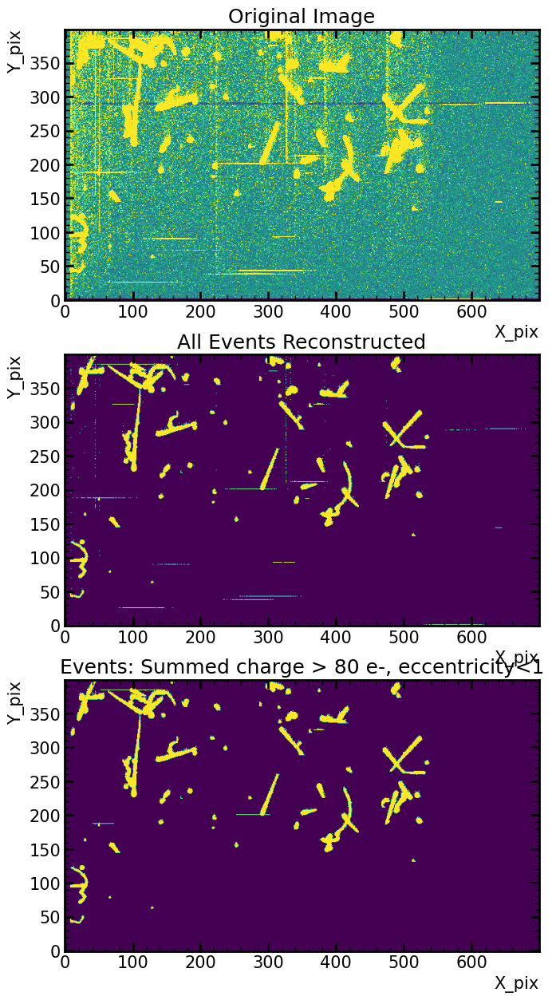

In [17]:
fig=plt.figure(figsize=(25,15))
plt.subplot(313)
plt.imshow(HE_events)
plt.title('Events: Summed charge > 80 e-, eccentricity<1')
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
# plt.colorbar()
plt.subplot(312)
plt.title('All Events Reconstructed')
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
plt.imshow(label!= 0)
plt.subplot(311)
plt.imshow(data[1],vmin=-1,vmax=1)
plt.title('Original Image')
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
plt.savefig('IMAGES_RECOHE.png', bbox_inches='tight', dpi=100)

plt.show()

In [18]:
mask_bleeding=ndimage.morphology.binary_dilation(HE_events>0,structure=[[0,0,0],[0,1,1],[0,0,0]],
                                             iterations=40)*1.0#-(HE_events>0)*1.0

/tmp/ipykernel_6775/107936838.py:1: DeprecationWarning: Please use `binary_dilation` from the `scipy.ndimage` namespace, the `scipy.ndimage.morphology` namespace is deprecated.
  mask_bleeding=ndimage.morphology.binary_dilation(HE_events>0,structure=[[0,0,0],[0,1,1],[0,0,0]],


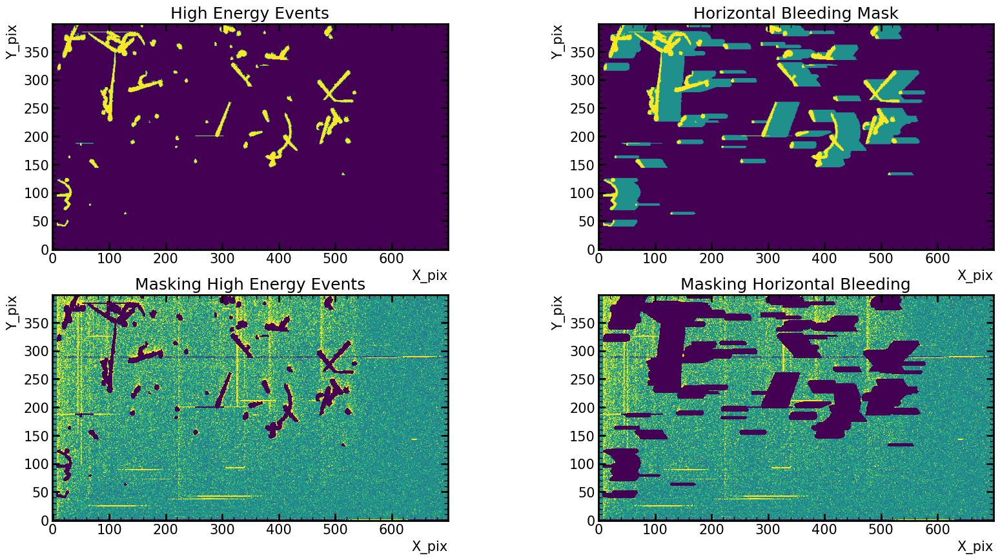

In [19]:
plt.figure(figsize=(20,10))
# plt.subplot(223)
# plt.imshow(data[0],vmin=-1,vmax=1)
# plt.title('Original Image')
plt.subplot(221)
plt.imshow(HE_events)
plt.title('High Energy Events')
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
plt.subplot(222)
plt.imshow(mask_bleeding+(HE_events>0)*1)
plt.title('Horizontal Bleeding Mask')

plt.ylabel('Y_pix')
plt.xlabel('X_pix')
plt.subplot(223)
plt.imshow(data[1]+((HE_events>0))*-1e7,vmin=-1,vmax=1)
plt.ylabel('Y_pix')
plt.xlabel('X_pix')

# plt.colorbar()
plt.title('Masking High Energy Events')
plt.subplot(224)
plt.imshow(data[1]+((mask_bleeding+HE_events>0))*-1e7,vmin=-1,vmax=1)
plt.ylabel('Y_pix')
plt.xlabel('X_pix')

plt.title('Masking Horizontal Bleeding')
plt.savefig('IMAGES_HBLEED.png', bbox_inches='tight', dpi=100)

plt.show()

In [20]:
maskV_bleeding=ndimage.morphology.binary_dilation(HE_events>0,structure=[[0,0,0],[0,1,0],[0,1,0]],
                                             iterations=20)*1.0#-(HE_events>0)*1.0

/tmp/ipykernel_6775/684858339.py:1: DeprecationWarning: Please use `binary_dilation` from the `scipy.ndimage` namespace, the `scipy.ndimage.morphology` namespace is deprecated.
  maskV_bleeding=ndimage.morphology.binary_dilation(HE_events>0,structure=[[0,0,0],[0,1,0],[0,1,0]],


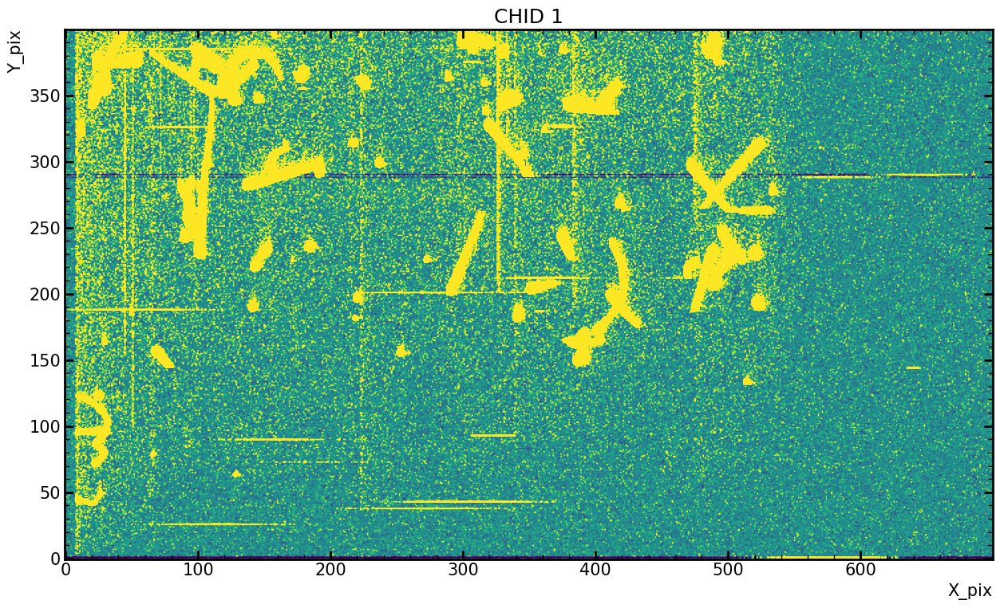

In [21]:
fig=plt.figure(figsize=(15,10))
plt.imshow(data[1],vmin=-1,vmax=1)
plt.title('CHID 1')
plt.savefig('IMAGES_chid1.png', bbox_inches='tight', dpi=100)
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
plt.show()

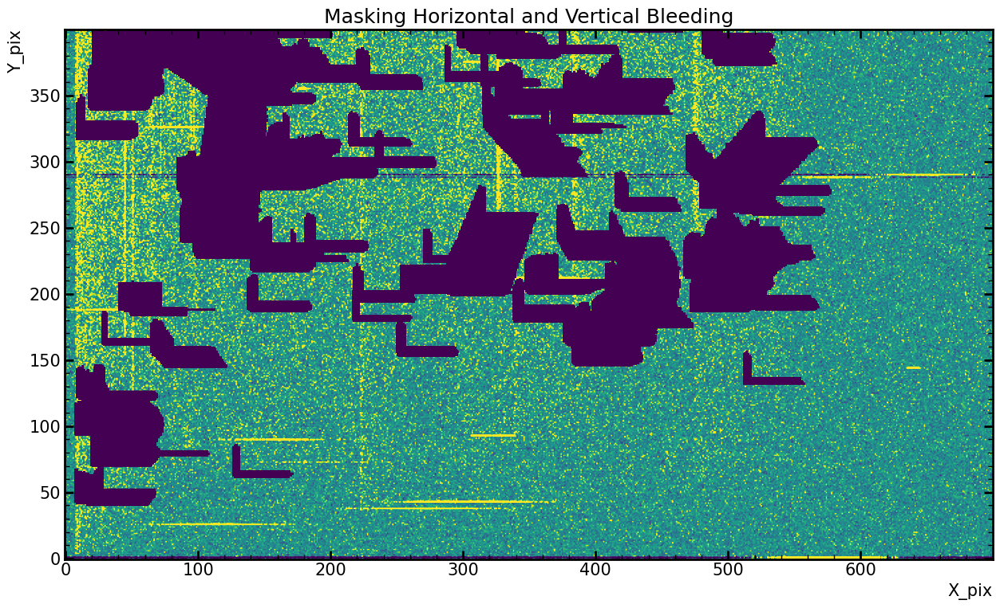

In [22]:
fig=plt.figure(figsize=(15,10))
plt.imshow(data[1]+((maskV_bleeding+mask_bleeding+HE_events>0))*-1e7,vmin=-1,vmax=1)
plt.title('Masking Horizontal and Vertical Bleeding')
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
plt.savefig('IMAGES_BLEED.png', bbox_inches='tight', dpi=100)

plt.show()

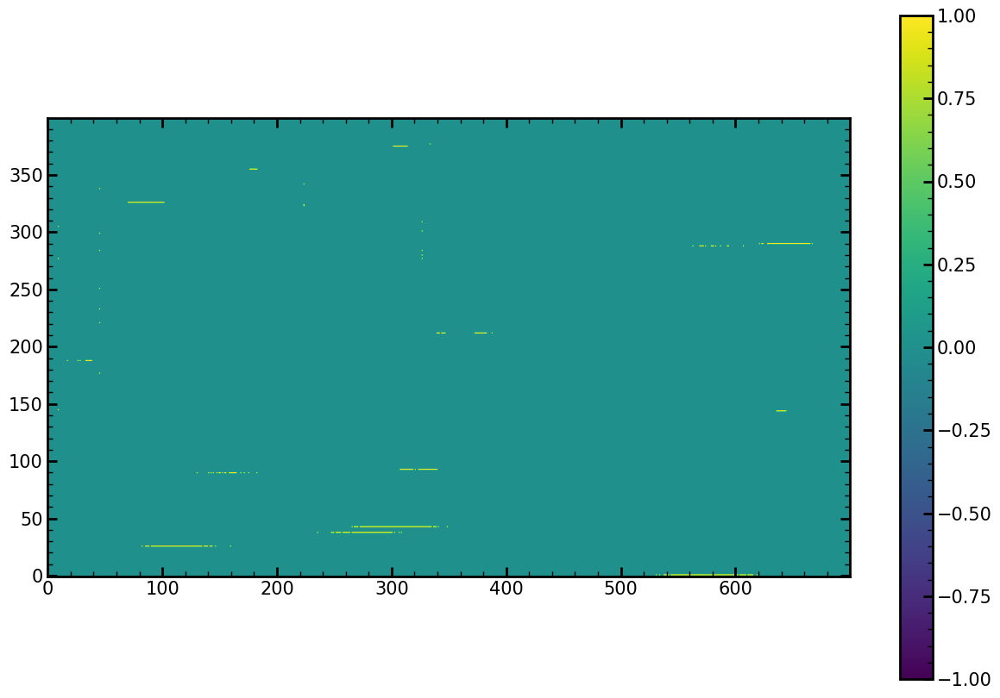

In [58]:
plt.figure(figsize=(15,10))
plt.imshow((data[1]+((maskV_bleeding+mask_bleeding+HE_events>0))*-1e7)>5,vmin=-1,vmax=1)
# plt.title('Masking Horizontal and Vertical Bleeding')
plt.colorbar()
plt.show()

In [59]:
matriz2, dmask=no_sr(data[1]+((maskV_bleeding+mask_bleeding+HE_events))*-1e7,threshold=5,trem=20)

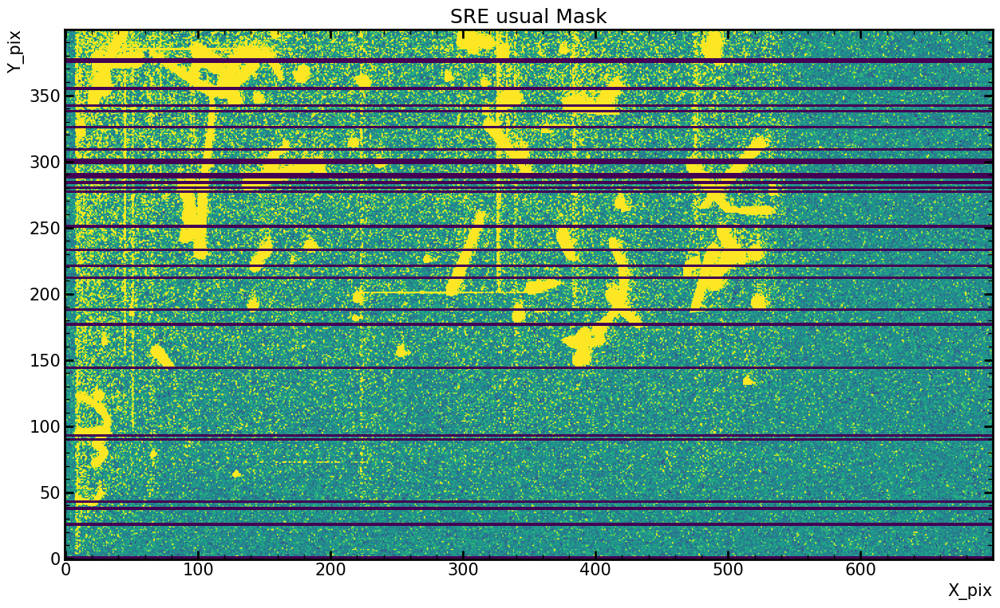

In [60]:
fig=plt.figure(figsize=(15,10))
plt.imshow(data[1]-dmask*1e7,vmin=-1,vmax=1)
plt.title('SRE usual Mask')
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
plt.savefig('IMAGES_SRE_std.png', bbox_inches='tight', dpi=100)
plt.show()

In [26]:
pre_sre=ndimage.label((data[1]+((maskV_bleeding+mask_bleeding+HE_events))*-1e7)>1.5,structure=[[0,0,0],[1,1,1],[0,0,0]])[0]

In [61]:
rps=sk.regionprops(pre_sre,cache=False)
areas=[r.area for r in rps]

SRE_events=np.zeros_like(pre_sre)
for event in np.where(np.array(areas)>)[0].tolist():
    [x,y]=np.where(pre_sre==event+1)
    for i in range(len(x)):
        SRE_events[x[i],y[i]]=1

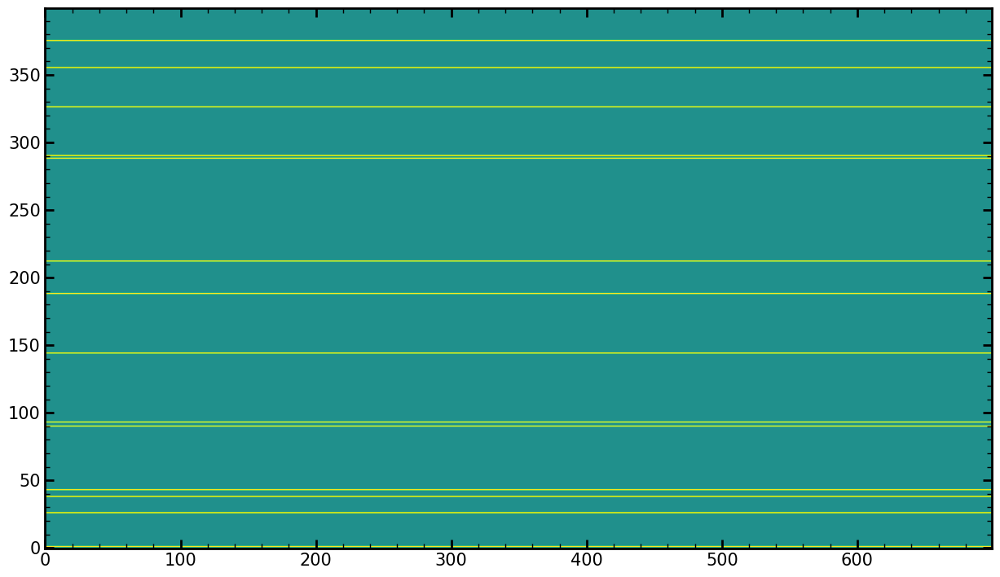

In [62]:
SRE_mask=np.zeros_like(SRE_events)
for y in np.unique(np.where(SRE_events==1)[0]).tolist(): SRE_mask[y,:]=1
plt.figure(figsize=(15,10))
plt.imshow(SRE_mask,vmin=-1,vmax=1)
plt.show()

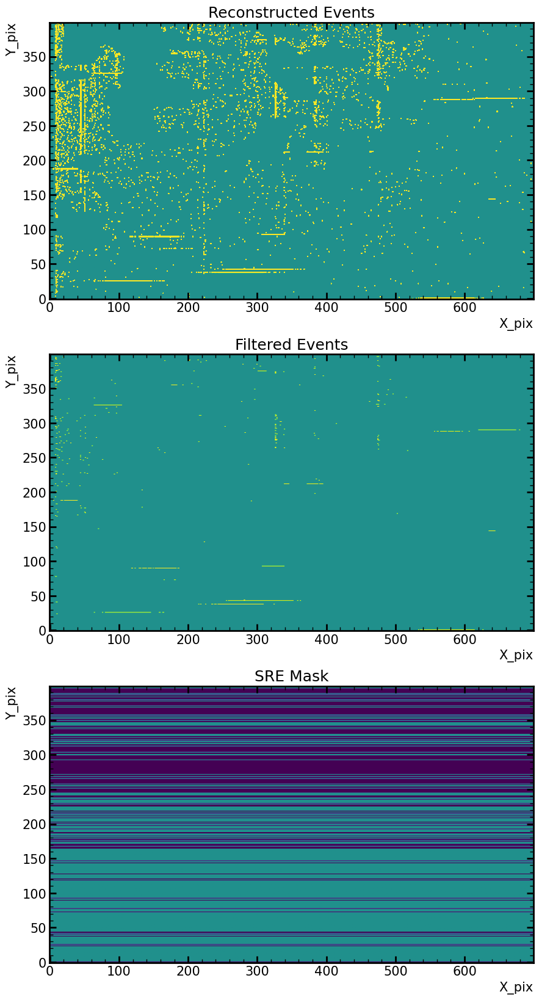

In [29]:
plt.figure(figsize=(25,20))
plt.subplot(311)
plt.imshow(pre_sre,vmin=-1,vmax=1)
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
plt.title('Reconstructed Events')
plt.subplot(312)
plt.imshow(SRE_events,vmin=-1,vmax=1)
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
plt.title('Filtered Events')
plt.subplot(313)
plt.imshow(-SRE_mask,vmin=-1,vmax=1)
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
plt.title('SRE Mask')
plt.savefig('IMAGES_SRE_pre.png', bbox_inches='tight', dpi=100)

plt.show()

In [30]:
np.unique(np.where(SRE_events==1)[0])

array([  1,  24,  26,  38,  41,  43,  44,  73,  78,  90,  93, 119, 121,
       128, 144, 147, 165, 166, 167, 169, 170, 171, 175, 177, 178, 180,
       183, 187, 188, 193, 198, 201, 203, 209, 212, 215, 217, 219, 226,
       227, 228, 230, 236, 239, 240, 241, 246, 247, 248, 249, 250, 251,
       253, 254, 257, 259, 260, 261, 262, 263, 264, 265, 267, 268, 270,
       271, 273, 274, 275, 276, 277, 278, 279, 280, 281, 282, 283, 284,
       285, 286, 287, 288, 289, 290, 291, 292, 294, 295, 296, 297, 298,
       299, 302, 303, 305, 306, 307, 308, 309, 310, 311, 312, 314, 315,
       318, 321, 323, 324, 326, 327, 331, 332, 333, 334, 335, 336, 337,
       339, 341, 342, 348, 349, 351, 352, 355, 357, 359, 360, 361, 362,
       363, 364, 365, 366, 367, 368, 370, 372, 373, 374, 375, 376, 377,
       379, 381, 382, 383, 385, 386, 388, 390, 391, 392, 393, 394, 395,
       396])

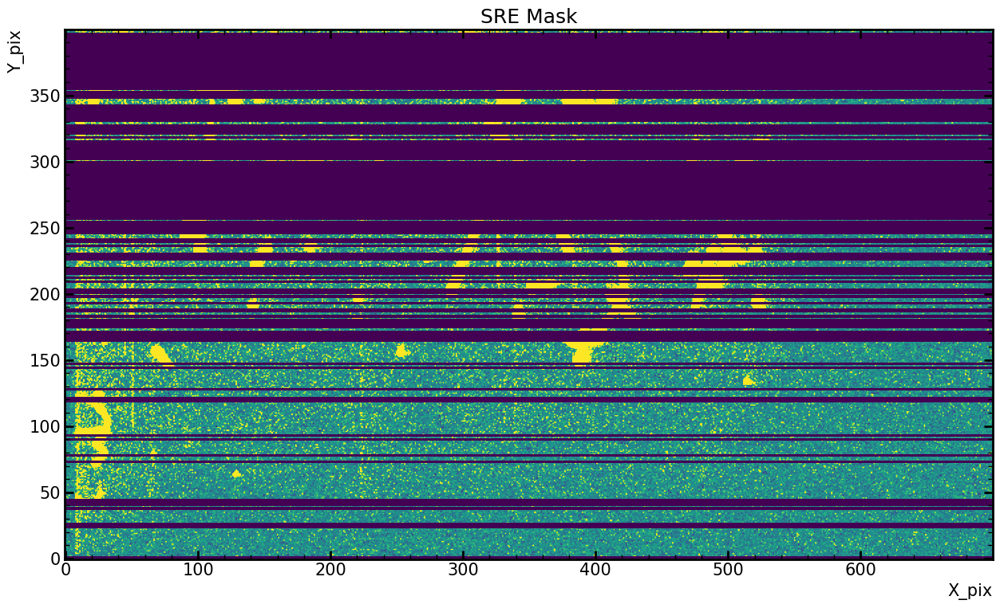

In [31]:
fig=plt.figure(figsize=(15,10))
plt.imshow(data[1]-1e7*SRE_mask,vmin=-1,vmax=1)
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
plt.title('SRE Mask')
plt.savefig('IMAGES_SRE_MASK.png', bbox_inches='tight', dpi=100)
plt.show()

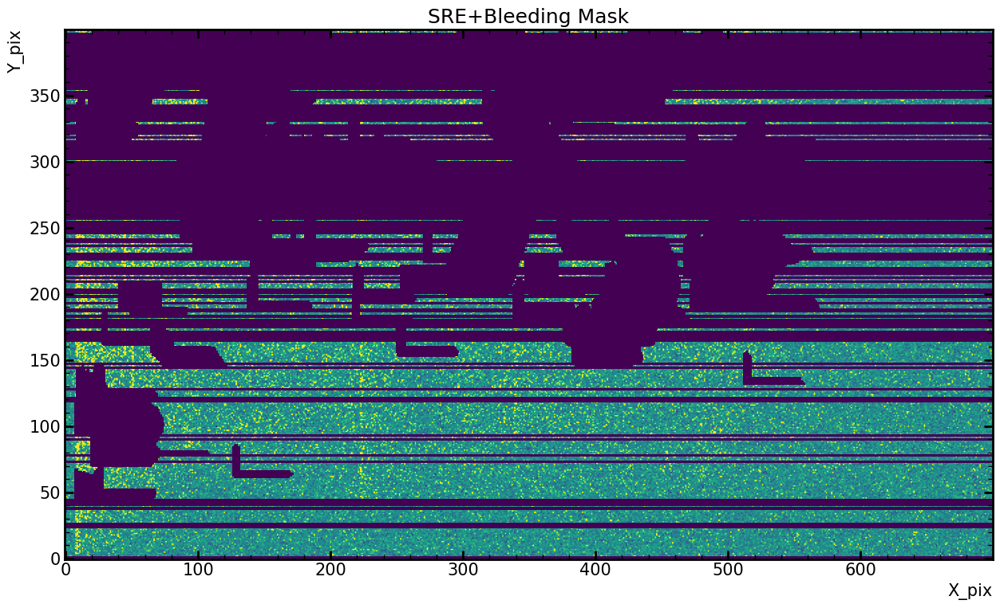

In [32]:
fig=plt.figure(figsize=(15,10))
plt.imshow(data[1]-1e7*(maskV_bleeding+mask_bleeding+SRE_mask),vmin=-1,vmax=1)
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
plt.title('SRE+Bleeding Mask')
plt.savefig('IMAGES_TOTALMASK.png', bbox_inches='tight', dpi=100)
plt.show()

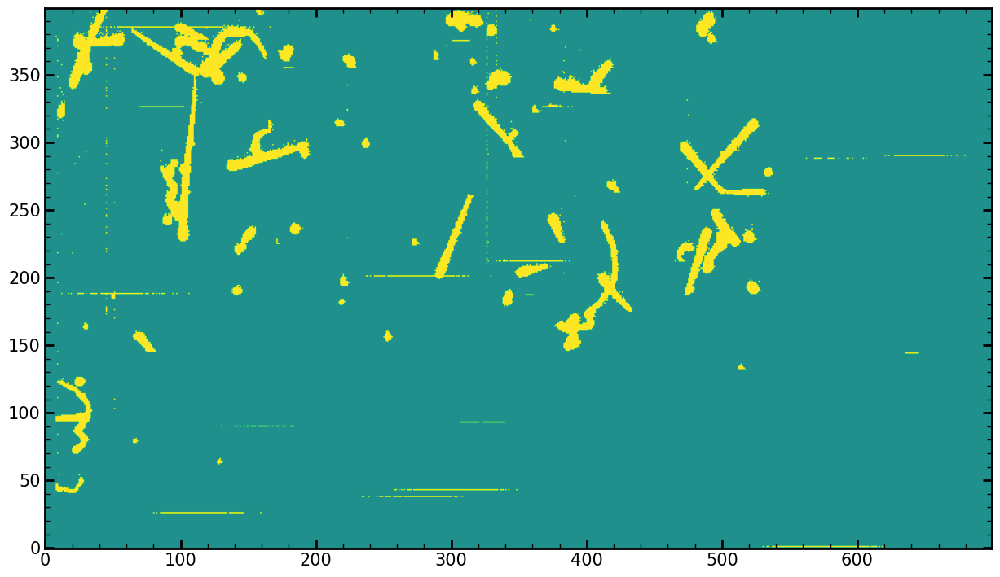

In [33]:
plt.figure(figsize=(15,10))
plt.imshow(label!=0,vmin=-1,vmax=1)
plt.show()

In [34]:
def sum_intensity(region, intensities):
    return np.sum(intensities[region])

rps=sk.regionprops(label,intensity_image=data[1],cache=False, extra_properties=[sum_intensity])
areas=[r.area for r in rps]
energy=[r.sum_intensity for r in rps]
centr=[r.weighted_centroid for r in rps]
ecce=[r.eccentricity for r in rps]
dic_props={"areas":areas,"energias":energy,'centroid':centr, "excentricidade":ecce}

In [35]:
flag0=[]
for i in range(len(centr)):
    if int(centr[i][0]) not in np.unique(np.where(SRE_events==1)[0]).tolist():
        
        flag0.append(i)

In [36]:
flag0_events=np.zeros_like(label)
for event in flag0:
    [x,y]=np.where(label==event+1)
    for i in range(len(x)):
        flag0_events[x[i],y[i]]=1

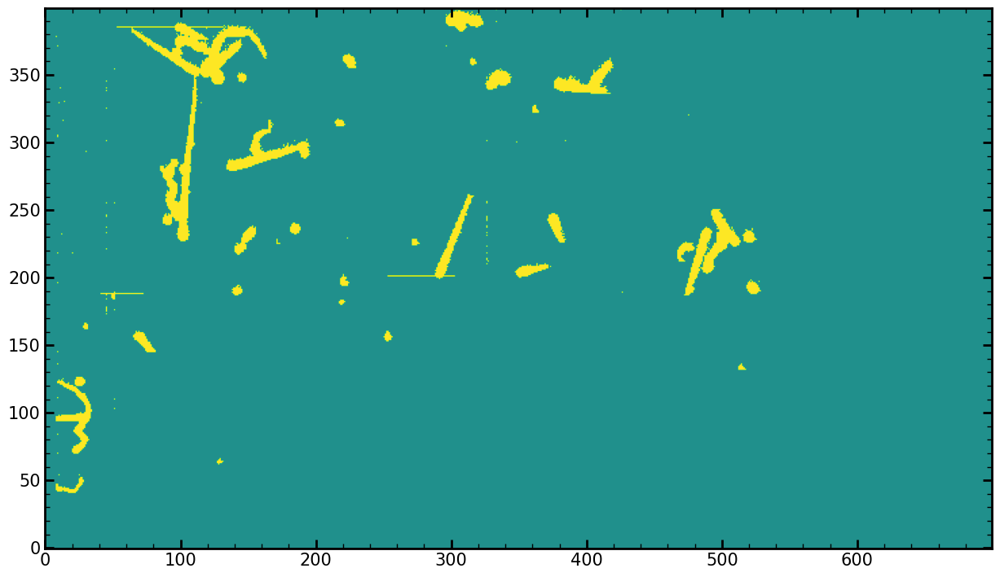

In [37]:
plt.figure(figsize=(15,10))
plt.imshow(flag0_events,vmin=-1,vmax=1)
plt.show()

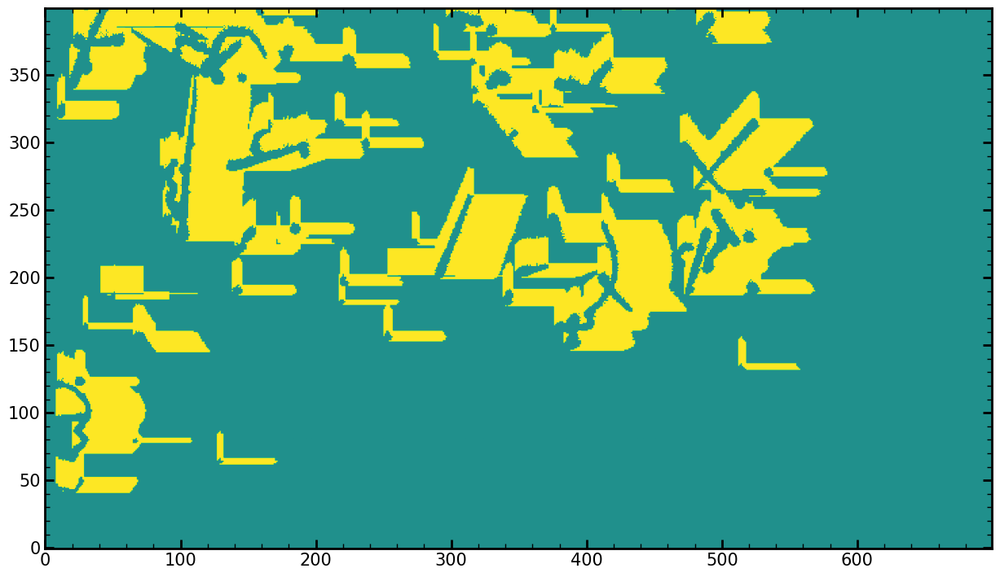

In [38]:
plt.figure(figsize=(15,10))
plt.imshow(maskV_bleeding+mask_bleeding-2*HE_events,vmin=-1,vmax=1)
plt.show()

In [39]:
type(centr[0] )

tuple

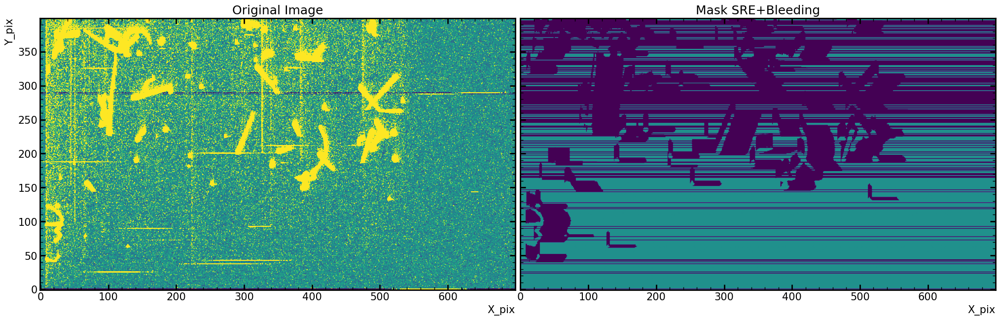

In [40]:
fig=plt.figure(figsize=(25,15))
plt.subplot(121)
plt.title('Original Image')
plt.imshow(data[1],vmin=-1,vmax=1)
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
plt.subplot(122)
plt.imshow(-(maskV_bleeding+mask_bleeding-2*HE_events+SRE_mask),vmin=-1,vmax=1)
plt.title('Mask SRE+Bleeding')
plt.tick_params('y', labelleft=False)
plt.subplots_adjust(wspace=0.01)
plt.xlabel('X_pix')
plt.savefig('Imageandmask.png', bbox_inches='tight', dpi=100)
plt.show()

In [41]:
summask=maskV_bleeding+mask_bleeding-2*HE_events+SRE_mask
bigmask=np.where(summask > 0, 1, 0)
Bary0=[]
Index=[]
for i in range(len(centr)):
    bary=tuple(int(item) for item in centr[i]) 
    if bigmask[bary[0],bary[1]]!=1:
        Bary0.append(bary)
        Index.append(i)

In [42]:
Flag0_events=np.zeros_like(label)
for event in Index:
    [x,y]=np.where(label==event+1)
    for i in range(len(x)):
        Flag0_events[x[i],y[i]]=1

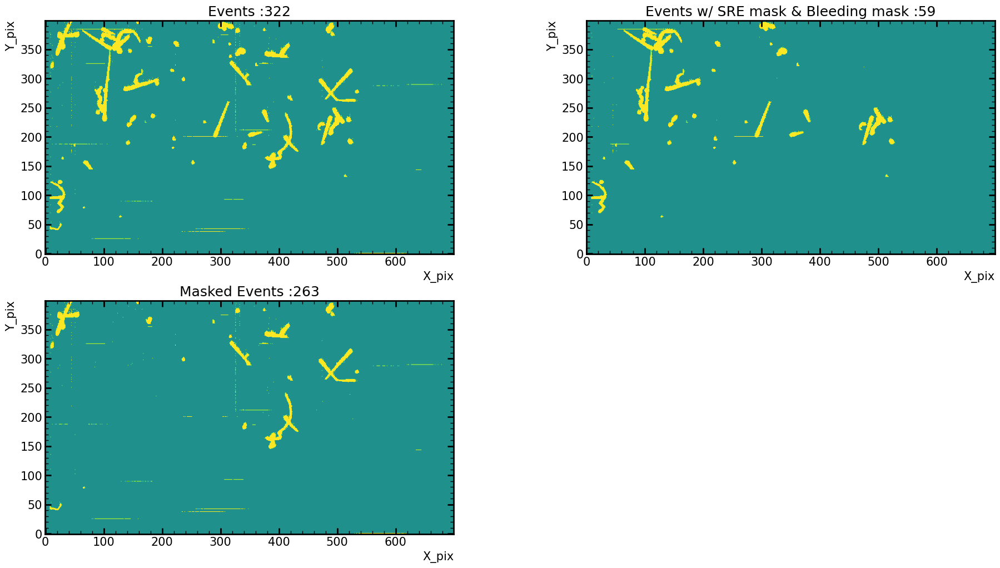

In [43]:
fig=plt.figure(figsize=(25,12))
plt.subplot(222)
plt.imshow(Flag0_events,vmin=-1,vmax=1)
plt.title('Events w/ SRE mask & Bleeding mask :'+str(len(Index)))
plt.xlabel("X_pix")
plt.ylabel("Y_pix")
plt.subplots_adjust(wspace=0.01)

plt.subplot(223)
plt.imshow((label!=0)-Flag0_events,vmin=-1,vmax=1)
plt.title('Masked Events :'+str(len(np.unique(label).tolist())-len(Index)))
plt.xlabel("X_pix")
plt.ylabel("Y_pix")
plt.subplots_adjust(wspace=0.01)

plt.subplot(221)
plt.imshow(label!=0,vmin=-1,vmax=1)
plt.title('Events :'+str(len(np.unique(label).tolist())))
plt.savefig('Recov2.png', bbox_inches='tight', dpi=100)
plt.xlabel("X_pix")
plt.ylabel("Y_pix")
plt.subplots_adjust(wspace=0.01)
plt.show()

In [44]:
len(centr)

321

321  baricenters


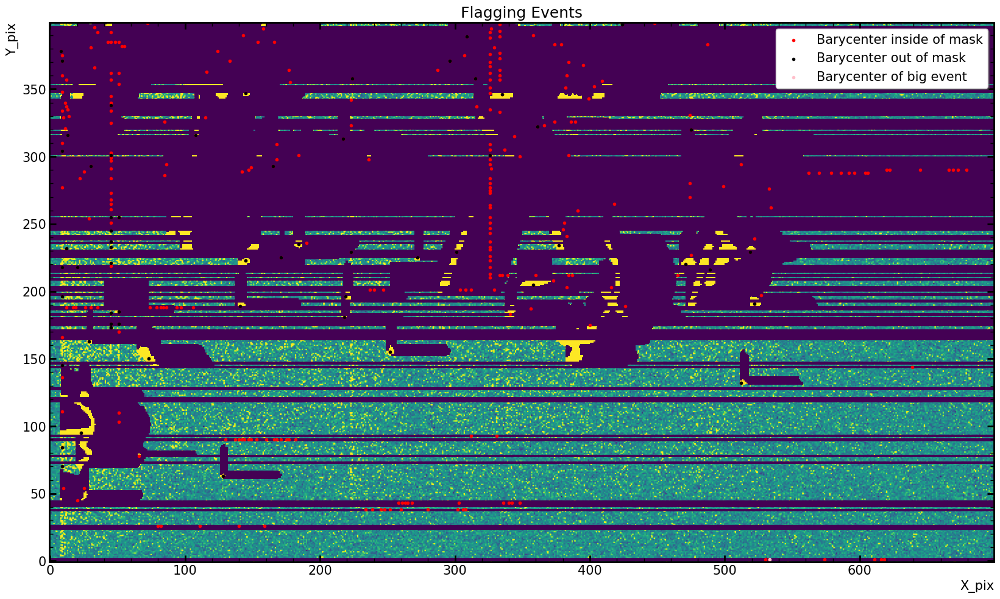

In [45]:
fig=plt.figure(figsize=(20,15))
plt.imshow(data[1]-bigmask*1e7,vmin=-1,vmax=1)
count=0
for i in range(len(centr)):
    bary=tuple(int(item) for item in centr[i]) 
    count+=1
    if i==0:plt.scatter(bary[1],bary[0],c='r',marker='.',label='Barycenter inside of mask')
    else: plt.scatter(bary[1],bary[0],marker='.',c='r')
print(count,' baricenters')
for baries in Bary0:
    plt.scatter(baries[1],baries[0],marker='.',c='k')
plt.scatter(baries[1],baries[0],marker='.',c='k',label='Barycenter out of mask')
plt.scatter(centr[1][1],centr[1][0],marker='.',c='pink',label='Barycenter of big event')
plt.legend(shadow=True)
plt.xlabel("X_pix")
plt.ylabel("Y_pix")
plt.title("Flagging Events")
plt.savefig('Baryv2.png', bbox_inches='tight', dpi=100)

plt.show()

321  baricenters


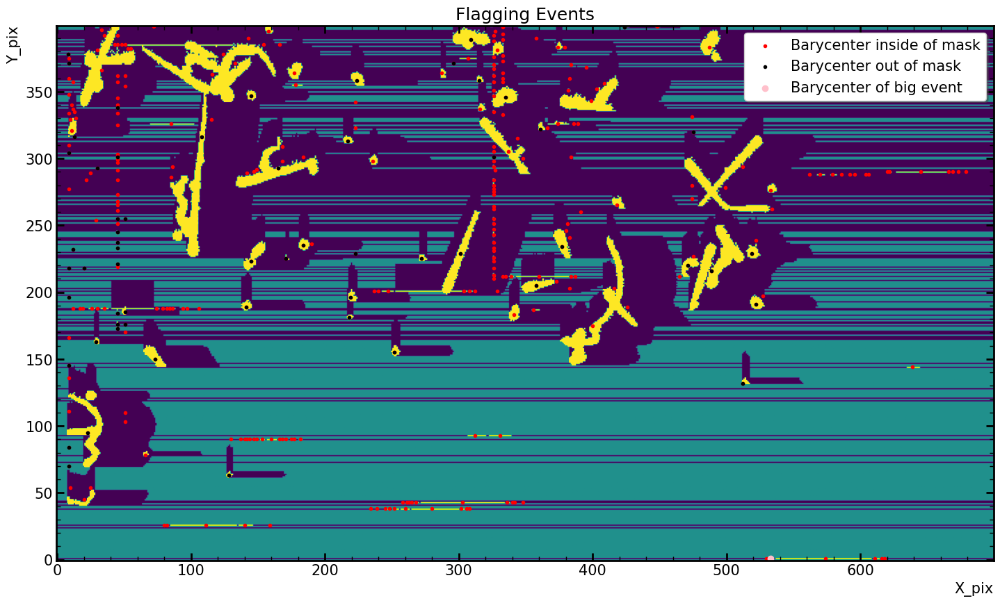

In [46]:
fig=plt.figure(figsize=(20,10))
MASK=2*(label!=0)-bigmask
# mask_eve=np.where((label!=0)==1,bigmask, -1)
# plt.imshow(-mask_eve,vmin=-1,vmax=1)
# plt.imshow(label!=0,vmin=-1,vmax=1)
plt.imshow(MASK,vmin=-1,vmax=1)

count=0
for i in range(len(centr)):
    bary=tuple(int(item) for item in centr[i]) 
    count+=1
    if i==0:plt.scatter(bary[1],bary[0],c='r',marker='.',label='Barycenter inside of mask')
    else: plt.scatter(bary[1],bary[0],c='r',marker='.')
print(count,' baricenters')
for baries in Bary0:
    plt.scatter(baries[1],baries[0],c='k',marker='.')
plt.scatter(baries[1],baries[0],c='k',marker='.',label='Barycenter out of mask')
plt.scatter(int(centr[1][1]),int(centr[1][0]),c='pink',label='Barycenter of big event')
plt.legend(shadow=True)
plt.xlabel("X_pix")
plt.ylabel("Y_pix")
plt.title("Flagging Events")
plt.savefig('Baryv3.png', bbox_inches='tight', dpi=100)

plt.show()

# SINGLE ELECTRON RATE

In [47]:
event_mask=maskV_bleeding+mask_bleeding
event_halo_mask = ndimage.binary_dilation(
        event_mask>0,
        iterations = 10,
        structure = ndimage.generate_binary_structure(rank=2, connectivity=2) # == [[1,1,1],[1,1,1],[1,1,1]]
    )
event_halo_SR_mask = np.array(SRE_mask,dtype=bool)|event_halo_mask

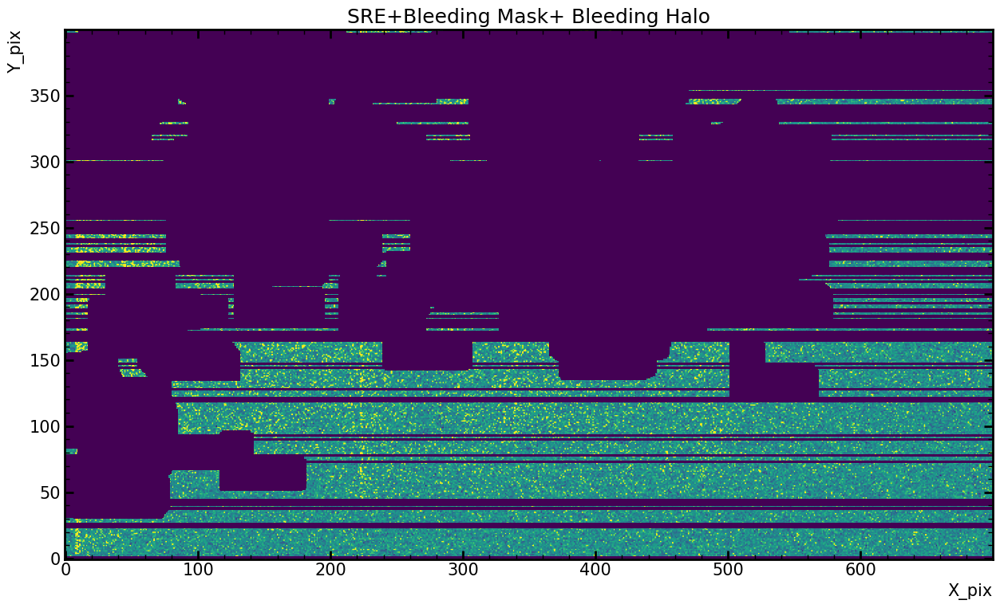

In [48]:
fig=plt.figure(figsize=(15,10))
plt.imshow(data[1]-1e7*event_halo_SR_mask,vmin=-1,vmax=1)
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
plt.title('SRE+Bleeding Mask+ Bleeding Halo')
plt.savefig('SER.png', bbox_inches='tight', dpi=100)
plt.show()

In [49]:
convolution_mask = np.s_[5:int(hdu_list[1].header["CCDNROW"])-5, 15:-(osc+5)]
masked_data = np.where(event_halo_SR_mask , np.nan, data[1] )
masked_hist, bins = np.histogram( masked_data[convolution_mask], np.arange(-0.5, 2.5, .01) )
x = (bins[1:]+bins[:-1])/2

In [50]:
sigma_list, sigma_errLlist=LocalSigma(data,extensions=4)
global sigma
sigmaN=sigma_list[1]
def poisson_normN(x, mu, A, lamb, Nmax=5): #sigma parameter global 
    y = 0.
    for i in range(0, Nmax+1):
        y += (lamb**i)/float(math.factorial(i)) *np.exp(-0.5*((x-i-mu-lamb)/float(sigmaN))**2)
    return A*np.exp(-lamb)*y/(np.sqrt(2*np.pi*sigmaN**2))

In [51]:

try:
    popt, pcov = curve_fit( 
        poisson_normN, 
        x, 
        masked_hist, 
        p0=[-0.4, 1000, 0.05],
    )
except (RuntimeError,OptimizeWarning,RuntimeWarning):
    print( f"Error - dc fit failed at" )

In [52]:
print(popt)
chid=1
start=parse(hdu_list[chid].header["DATESTART"]+"Z").timestamp()
end=parse(hdu_list[chid].header["DATEEND"]+"Z").timestamp()
time=datetime.timedelta(seconds=end-start)
readout_time=time.total_seconds()/86400 #readout time in days

exposure_time=readout_time*int(hdu_list[chid].header["CCDNROW"])/(2*int(hdu_list[chid].header["NROW"]))
print(exposure_time)
perr = np.sqrt(np.diag(pcov))
dc = popt[2]/exposure_time # electron/pix/day
dc_err = perr[2]/exposure_time # electron/pix/day
print(dc,dc_err)

[ -0.17397902 110.0697597    0.15634731]
0.08327708333333333
1.8774349795695302 0.06320960393877759


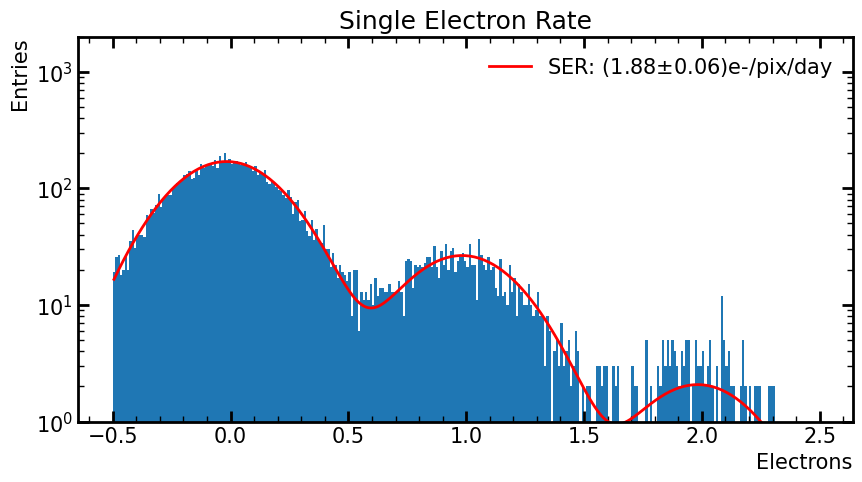

In [53]:
fig=plt.figure(figsize=(10,5))
plt.bar(x,masked_hist,width=0.01)
plt.plot(x,poisson_normN(x,*popt),linewidth=2,c='r',label=r'SER: ({:.2f}$\pm${:.2f})e-/pix/day'.format(dc,dc_err))
plt.yscale('log')
plt.ylim(1,2e3)
plt.ylabel('Entries')
plt.xlabel('Electrons')
plt.title('Single Electron Rate')
plt.legend()
plt.savefig('SER_HISTO.png', bbox_inches='tight', dpi=100)

plt.show()

In [54]:
centr[144]

(241.0, 383.0)

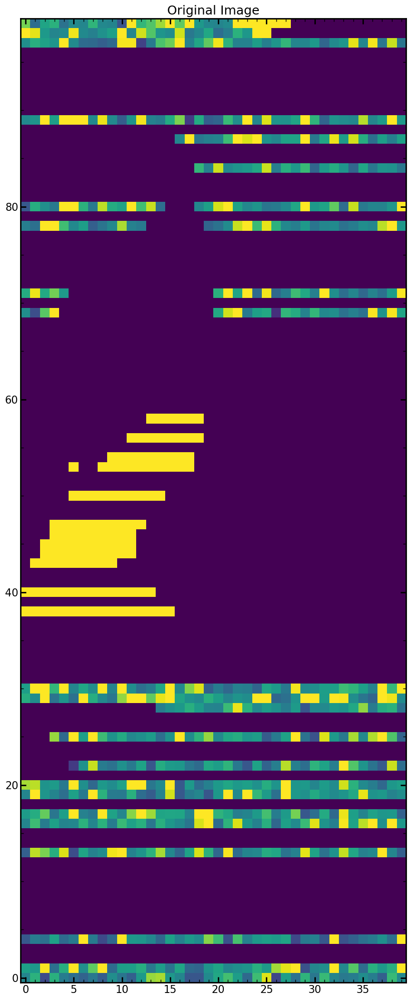

In [55]:
fig=plt.figure(figsize=(25,25))
# plt.subplot(121)
plt.title('Original Image')
plt.imshow((data[1]-(maskV_bleeding+mask_bleeding-2*HE_events+SRE_mask)*1e7)[300:,400:440],vmin=-1,vmax=1)

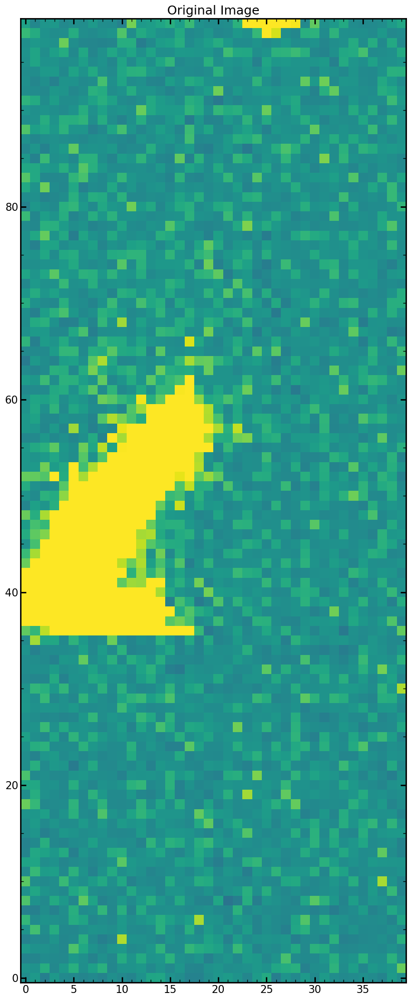

In [56]:
fig=plt.figure(figsize=(25,25))
# plt.subplot(121)
plt.title('Original Image')
plt.imshow(data[1][300:,400:440],vmin=-4,vmax=4)

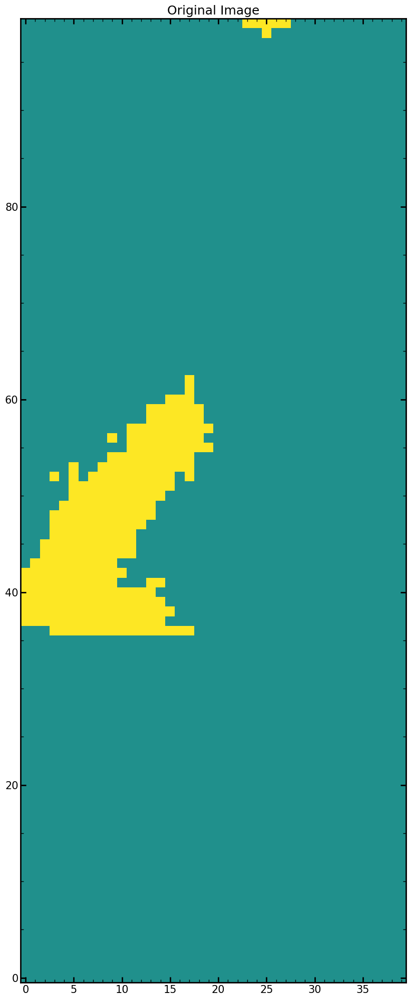

In [57]:
fig=plt.figure(figsize=(25,25))
# plt.subplot(121)
plt.title('Original Image')
plt.imshow((label!=0)[300:,400:440],vmin=-1,vmax=1)